
# 1. Setup



In [23]:
import pandas as pd
import numpy as np
import plotly.express as px
import matplotlib.pyplot as plt

pd.set_option('display.max_columns', None)
pd.options.mode.copy_on_write = True

# Using the URL for the file
spotify_original = pd.read_csv("spotify_data/dataset.csv")

spotify_original_reshape = spotify_original.iloc[:,1:]

# 2. Data Cleaning


*   Todo 1
*   Todo 2



In [24]:
#spotify_original_reshape.head(20)
#spotify_original.shape
spotify_original_reshape




,track_id,artists,album_name,track_name,popularity,duration_ms,explicit,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre
0,5SuOikwiRyPMVoIQDJUgSV,Gen Hoshino,Comedy,Comedy,73,230666,False,0.676,0.4610,1,-6.746,0,0.1430,0.0322,0.000001,0.3580,0.7150,87.917,4,acoustic
1,4qPNDBW1i3p13qLCt0Ki3A,Ben Woodward,Ghost (Acoustic),Ghost - Acoustic,55,149610,False,0.420,0.1660,1,-17.235,1,0.0763,0.9240,0.000006,0.1010,0.2670,77.489,4,acoustic
2,1iJBSr7s7jYXzM8EGcbK5b,Ingrid Michaelson;ZAYN,To Begin Again,To Begin Again,57,210826,False,0.438,0.3590,0,-9.734,1,0.0557,0.2100,0.000000,0.1170,0.1200,76.332,4,acoustic
3,6lfxq3CG4xtTiEg7opyCyx,Kina Grannis,Crazy Rich Asians (Original Motion Picture Sou...,Can't Help Falling In Love,71,201933,False,0.266,0.0596,0,-18.515,1,0.0363,0.9050,0.000071,0.1320,0.1430,181.740,3,acoustic
4,5vjLSffimiIP26QG5WcN2K,Chord Overstreet,Hold On,Hold On,82,198853,False,0.618,0.4430,2,-9.681,1,0.0526,0.4690,0.000000,0.0829,0.1670,119.949,4,acoustic
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
113995,2C3TZjDRiAzdyViavDJ217,Rainy Lullaby,#mindfulness - Soft Rain for Mindful Meditatio...,Sleep My Little Boy,21,384999,False,0.172,0.2350,5,-16.393,1,0.0422,0.6400,0.928000,0.0863,0.0339,125.995,5,world-music
113996,1hIz5L4IB9hN3WRYPOCGPw,Rainy Lullaby,#mindfulness - Soft Rain for Mindful Meditatio...,Water Into Light,22,385000,False,0.174,0.1170,0,-18.318,0,0.0401,0.9940,0.976000,0.1050,0.0350,85.239,4,world-music
113997,6x8ZfSoqDjuNa5SVP5QjvX,Cesária Evora,Best Of,Miss Perfumado,22,271466,False,0.629,0.3290,0,-10.895,0,0.0420,0.8670,0.000000,0.0839,0.7430,132.378,4,world-music
113998,2e6sXL2bYv4bSz6VTdnfLs,Michael W. Smith,Change Your World,Friends,41,283893,False,0.587,0.5060,7,-10.889,1,0.0297,0.3810,0.000000,0.2700,0.4130,135.960,4,world-music


In [25]:
spotify_original_reshape['track_name'].describe()

count              113999
unique              73608
top       Run Rudolph Run
freq                  151
Name: track_name, dtype: object

In [26]:
spotify_original_reshape['popularity'].describe()

count    114000.000000
mean         33.238535
std          22.305078
min           0.000000
25%          17.000000
50%          35.000000
75%          50.000000
max         100.000000
Name: popularity, dtype: float64

In [27]:
spotify_original_reshape['track_genre'].describe()

count       114000
unique         114
top       acoustic
freq          1000
Name: track_genre, dtype: object

In [28]:
missing_track = spotify_original_reshape[spotify_original_reshape['track_id'] == '1kR4gIb7nGxHPI3D2ifs59']
print(missing_track)

                     track_id artists album_name track_name  popularity  \
65900  1kR4gIb7nGxHPI3D2ifs59     NaN        NaN        NaN           0   

       duration_ms  explicit  danceability  energy  key  loudness  mode  \
65900            0     False         0.501   0.583    7     -9.46     0   

       speechiness  acousticness  instrumentalness  liveness  valence  \
65900       0.0605          0.69           0.00396    0.0747    0.734   

         tempo  time_signature track_genre  
65900  138.391               4       k-pop  


In [29]:
# Cleaning rows with missing information
missing_data_rows = spotify_original_reshape[spotify_original_reshape.isnull().any(axis=1)]

missing_data_rows

spotify_original_reshape_drop = spotify_original_reshape.dropna()

print(spotify_original_reshape.shape)
print(spotify_original_reshape_drop.shape)

(114000, 20)
(113999, 20)


In [30]:
#clean track_name and artists columns by stripping spaces and converting to lowercase
spotify_original_reshape_drop['track_name_clean'] = spotify_original_reshape_drop['track_name'].str.strip().str.lower()
spotify_original_reshape_drop['artists_clean'] = spotify_original_reshape_drop['artists'].str.strip().str.lower()

#priority list for genres to handle duplicates
genre_priority = ['pop', 'rock', 'hip hop', 'rap', 'reggaeton', 'latin', 'electronic', 'r&b', 'reggae', 'dance', 'classical']
spotify_original_reshape_drop['genre_priority'] = spotify_original_reshape_drop['track_genre'].apply(lambda x: genre_priority.index(x) if x in genre_priority else len(genre_priority))

#sort the dataset by track_name, artists, genre priority, popularity, and duration
spotify_data_sorted = spotify_original_reshape_drop.sort_values(by=['track_name_clean', 'artists_clean', 'genre_priority', 'popularity', 'duration_ms'],
                                                                ascending=[True, True, True, True, False])

#remove duplicates
spotify_cleaned = spotify_data_sorted.drop_duplicates(subset=['track_name_clean', 'artists_clean'], keep='first')

# checking size
print(f"Shape of the dataset before cleaning: {spotify_original_reshape_drop.shape}")
print(f"Shape of the dataset after cleaning: {spotify_cleaned.shape}")

# removing extra columns added
spotify_cleaned_final = spotify_cleaned.drop(columns=['track_name_clean', 'artists_clean', 'genre_priority'])

# Fcheck size again
print(f"Shape of the dataset after removing extra columns: {spotify_cleaned_final.shape}")


spotify_cleaned_final


Shape of the dataset before cleaning: (113999, 23)
Shape of the dataset after cleaning: (81206, 23)
Shape of the dataset after removing extra columns: (81206, 20)


,track_id,artists,album_name,track_name,popularity,duration_ms,explicit,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre
36750,0fROT4kK5oTm8xO8PX6EJF,Rilès,!I'll Be Back!,!I'll Be Back!,52,178533,True,0.823,0.6120,1,-7.767,1,0.2480,0.1680,0.000000,0.1090,0.6880,142.959,4,french
92751,1hH0t381PIXmUVWyG1Vj3p,Brian Hyland,The Bashful Blond,"""A"" You're Adorable",39,151680,False,0.615,0.3750,0,-10.362,0,0.0319,0.4820,0.000000,0.1110,0.9220,110.720,4,rockabilly
66996,73lXf5if6MWVWnsgXhK8bd,Little Apple Band,Sesame Street and Friends,"""C"" is for Cookie",8,86675,False,0.664,0.6110,3,-8.687,1,0.0886,0.1200,0.000000,0.0408,0.7580,118.443,4,kids
101161,0jmz4aHEIBCRgrcV2xEkwB,Traditional;Sistine Chapel Choir;Massimo Palom...,Classical Christmas,"""Christe, Redemptor omnium""",0,289133,False,0.111,0.0568,10,-28.053,1,0.0551,0.9900,0.697000,0.1100,0.0395,169.401,1,sleep
82584,5Zx0Rrkn5RFBMD2PRxX3mI,Dillinger Four,C I V I L W A R,"""Contemplate This on the Tree of Woe.""",24,180706,False,0.565,0.9770,11,-3.592,1,0.0546,0.0282,0.001320,0.4330,0.3870,106.478,4,power-pop
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
65756,2oVHb8wyg6oC2iNpGBNvx1,HEIZE,Hotel del Luna (Original Television Soundtrack...,내 맘을 볼 수 있나요,63,225785,False,0.397,0.1660,9,-10.678,1,0.0349,0.8840,0.000000,0.1000,0.1310,134.708,4,k-pop
65859,4kIpBfvK44bxqX7zo8K1oP,Gaho,ITAEWON CLASS (Original Television Soundtrack)...,시작,65,202440,False,0.591,0.8180,4,-3.532,1,0.0730,0.1720,0.000000,0.1260,0.5740,108.107,4,k-pop
75903,4mHc7LUlO3k6AXeFV2EiJK,Yiruma,Yiruma Official Album 'Piano Therapy' (The Ori...,약속 (Piano Solo),37,144533,False,0.504,0.1430,1,-18.713,1,0.0701,0.9800,0.922000,0.1240,0.0584,148.786,4,new-age
79554,0tQesiSZJQOdHeAC7r59us,GODA,One Punch Man (Original Soundtrack),원펀맨 Theme - Sad Theme,37,228000,False,0.542,0.3370,2,-16.088,1,0.0539,0.9850,0.933000,0.1470,0.4430,159.951,4,piano


# 3. Exploratory Data Analysis




In [31]:
"""
Removing Non-Int Features for Histogram Analysis
"""
numeric_data = spotify_cleaned_final.select_dtypes(include=['float64', 'int64'])
numeric_data

numeric_data.head()

,popularity,duration_ms,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature
36750,52,178533,0.823,0.6120,1,-7.767,1,0.2480,0.1680,0.00000,0.1090,0.6880,142.959,4
92751,39,151680,0.615,0.3750,0,-10.362,0,0.0319,0.4820,0.00000,0.1110,0.9220,110.720,4
66996,8,86675,0.664,0.6110,3,-8.687,1,0.0886,0.1200,0.00000,0.0408,0.7580,118.443,4
101161,0,289133,0.111,0.0568,10,-28.053,1,0.0551,0.9900,0.69700,0.1100,0.0395,169.401,1
82584,24,180706,0.565,0.9770,11,-3.592,1,0.0546,0.0282,0.00132,0.4330,0.3870,106.478,4


Text(0.5, 1.0, 'Liveness Histogram')

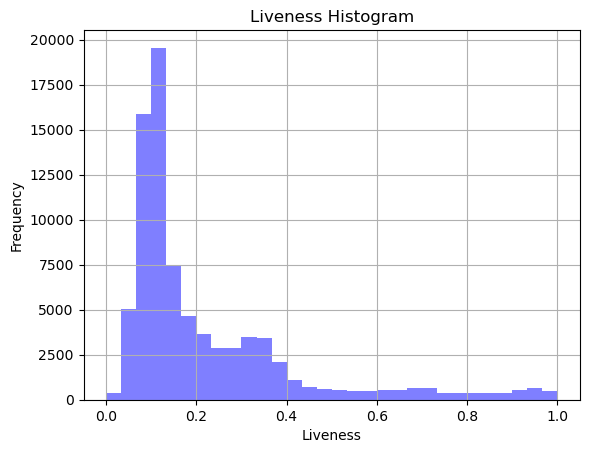

In [32]:
"""
Histograms for Numeric Features
"""
numeric_data['liveness'].hist(bins = 30, alpha = 0.5, color='blue')
plt.xlabel('Liveness')
plt.ylabel('Frequency')
plt.title('Liveness Histogram')

Text(0.5, 1.0, 'Liveness Histogram')

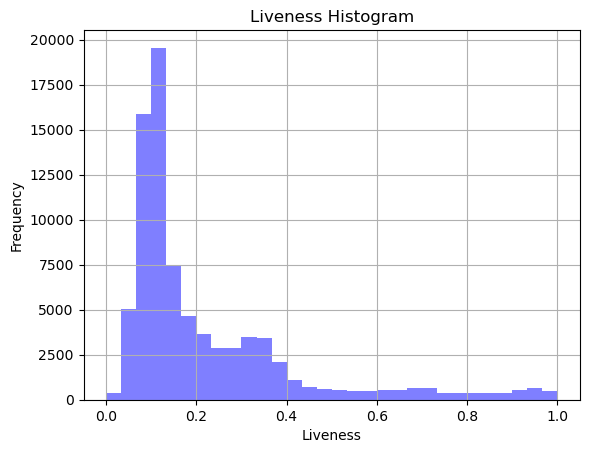

In [33]:
"""
Histograms for Numeric Features
"""
numeric_data['liveness'].hist(bins = 30, alpha = 0.5, color='blue')
plt.xlabel('Liveness')
plt.ylabel('Frequency')
plt.title('Liveness Histogram')

Text(0.5, 1.0, 'Popularity Histogram')

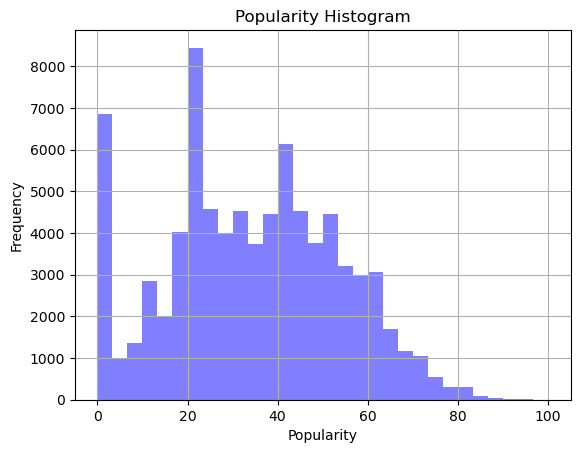

In [34]:
numeric_data['popularity'].hist(bins = 30, alpha = 0.5, color='blue')
plt.xlabel('Popularity')
plt.ylabel('Frequency')
plt.title('Popularity Histogram')

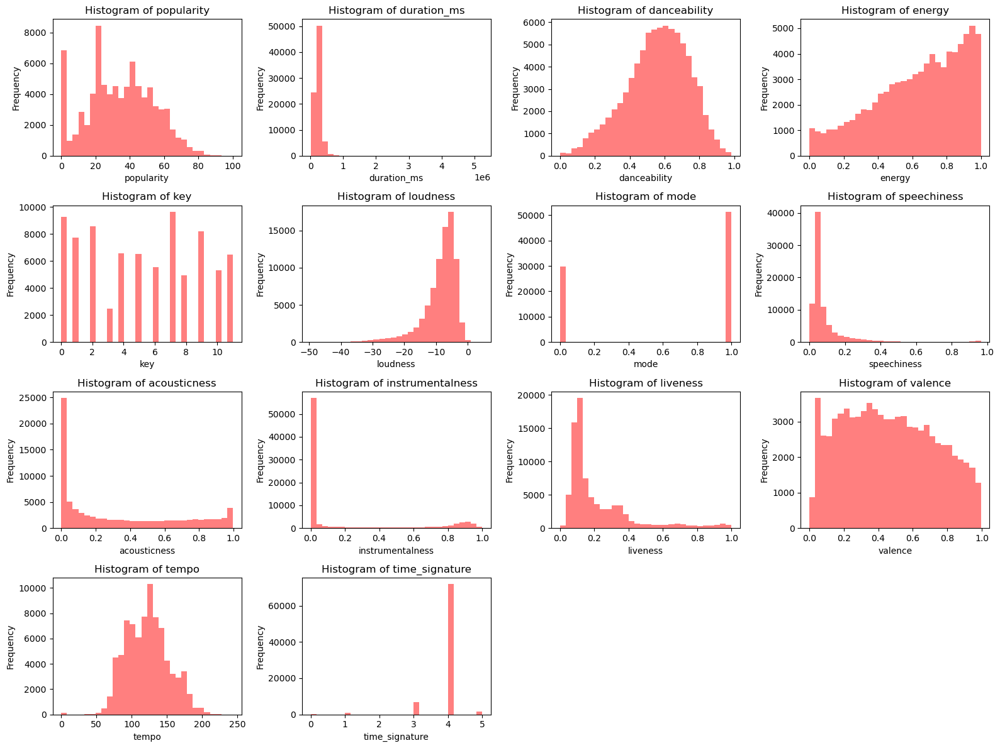

In [35]:
features = numeric_data.columns[:14]
n_features = len(features)
n_cols = 4
n_rows = -(-n_features // n_cols)

fig, axes = plt.subplots(n_rows, n_cols, figsize=(16,12))
axes = axes.flatten()

for i, feature in enumerate(features):
  axes[i].hist(numeric_data[feature], bins=30, alpha=0.5, color='red')
  axes[i].set_title(f'Histogram of {feature}')
  axes[i].set_xlabel(feature)
  axes[i].set_ylabel('Frequency')

for j in range(i + 1, len(axes)):
  axes[j].axis('off')

plt.tight_layout()
plt.show()

In [36]:
"""
Histograms for Categorical Features
"""
categorical_data = spotify_cleaned_final.select_dtypes(include=['object'])
categorical_data.head()
categorical_data_clean = categorical_data.drop(columns=['track_name', 'track_id','artists','album_name'])

categorical_data_clean.head()

,track_genre
36750,french
92751,rockabilly
66996,kids
101161,sleep
82584,power-pop


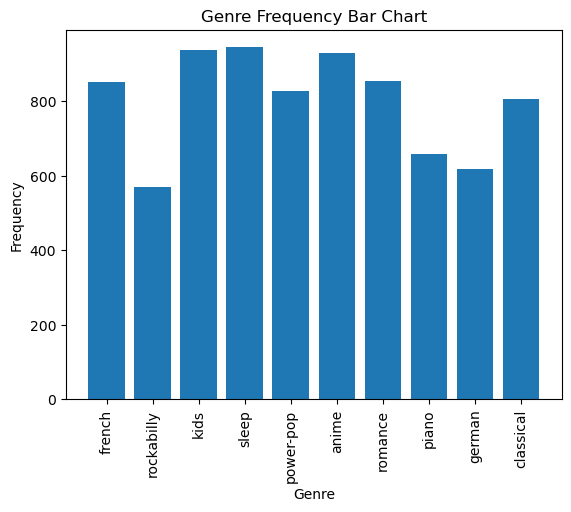

In [37]:
genres_count = {}

for genre in categorical_data['track_genre']:
  if genre not in genres_count:
    genres_count[genre] = 0
  genres_count[genre]+=1

plt.bar(list(genres_count.keys())[:10], list(genres_count.values())[:10])
plt.xticks(rotation=90)
plt.xlabel('Genre')
plt.ylabel('Frequency')
plt.title('Genre Frequency Bar Chart')

plt.show()

Text(0.5, 1.0, 'Energy vs Popularity')

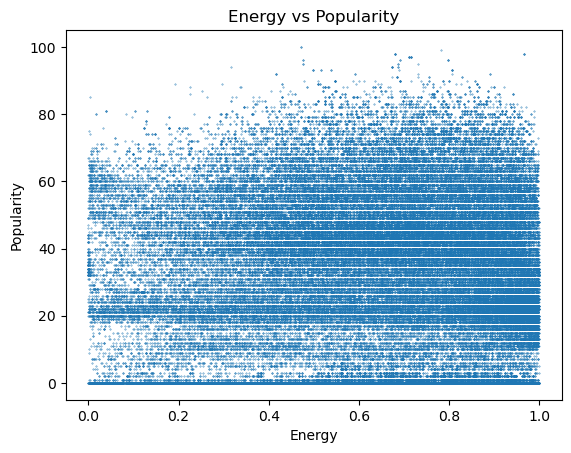

In [38]:
"""
Visualizing correlation between energy and popularity
"""

plt.scatter(spotify_original_reshape['energy'], spotify_original_reshape['popularity'], s = 0.1)
plt.xlabel('Energy')
plt.ylabel('Popularity')
plt.title('Energy vs Popularity')

In [39]:
"""
Visualizing the Correlation Between Popularity and other features
"""

for features in spotify_original_reshape.select_dtypes(include=[np.number]).columns:
  print(features, 'vs. Popularity Correlation:', np.corrcoef(spotify_original_reshape['popularity'], spotify_original_reshape[features])[0,1])


popularity vs. Popularity Correlation: 1.0
duration_ms vs. Popularity Correlation: -0.007101208619704766
danceability vs. Popularity Correlation: 0.03544813475138599
energy vs. Popularity Correlation: 0.001056136299698507
key vs. Popularity Correlation: -0.003853154715560715
loudness vs. Popularity Correlation: 0.050423036100497774
mode vs. Popularity Correlation: -0.013930786753107906
speechiness vs. Popularity Correlation: -0.04492654926158635
acousticness vs. Popularity Correlation: -0.02547241256836337
instrumentalness vs. Popularity Correlation: -0.09513920344466423
liveness vs. Popularity Correlation: -0.005387153831593012
valence vs. Popularity Correlation: -0.040534294659946325
tempo vs. Popularity Correlation: 0.013204659932994902
time_signature vs. Popularity Correlation: 0.031072758760108017


In [40]:
"""
Visualizing the Correlation Between Tempo and other features
"""

for features in spotify_original_reshape.select_dtypes(include=[np.number]).columns:
  print(features, 'vs. Tempo Correlation:', np.corrcoef(spotify_original_reshape['tempo'], spotify_original_reshape[features])[0,1])


popularity vs. Tempo Correlation: 0.013204659932994902
duration_ms vs. Tempo Correlation: 0.024345605690600364
danceability vs. Tempo Correlation: -0.050449871431220004
energy vs. Tempo Correlation: 0.2478505098026229
key vs. Tempo Correlation: 0.01091661911281033
loudness vs. Tempo Correlation: 0.2124458965795149
mode vs. Tempo Correlation: 0.000565558105794505
speechiness vs. Tempo Correlation: 0.01727322333048465
acousticness vs. Tempo Correlation: -0.20822414719631285
instrumentalness vs. Tempo Correlation: -0.05033040132787468
liveness vs. Tempo Correlation: 0.0005997673113031102
valence vs. Tempo Correlation: 0.07827306763947273
tempo vs. Tempo Correlation: 0.9999999999999999
time_signature vs. Tempo Correlation: 0.06664108820639164


danceability        1.000000
valence             0.492137
loudness            0.265067
time_signature      0.207024
energy              0.134576
speechiness         0.108483
popularity          0.084179
key                 0.032563
tempo              -0.015294
mode               -0.059259
duration_ms        -0.060047
liveness           -0.132165
acousticness       -0.167830
instrumentalness   -0.191710
Name: danceability, dtype: float64


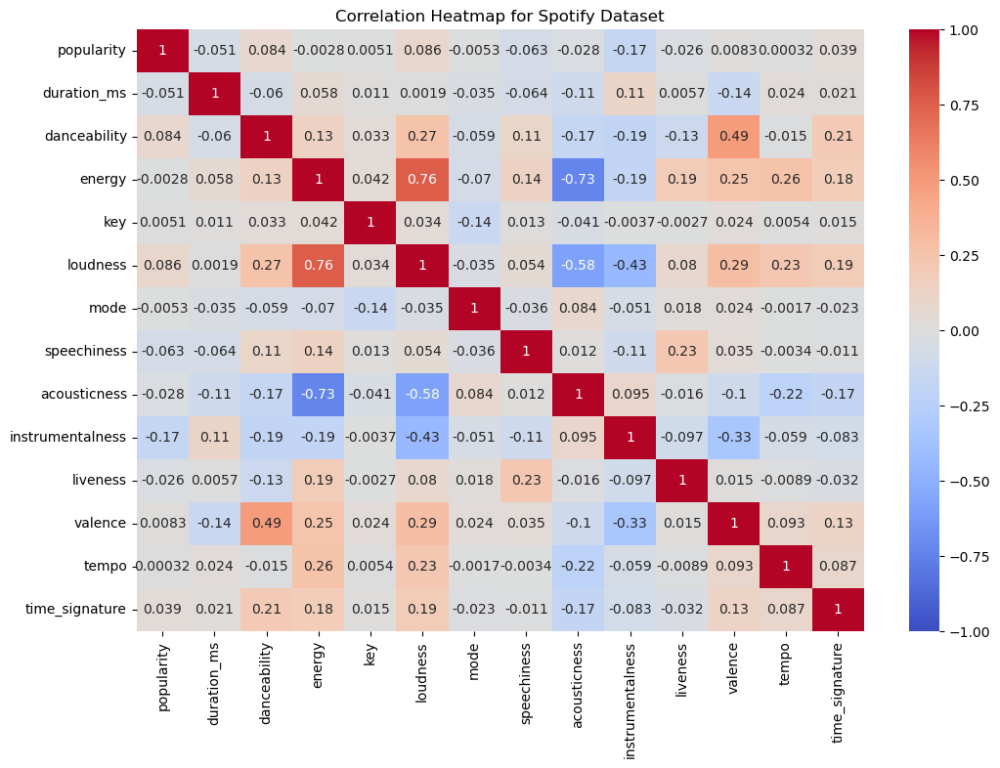

In [41]:
"""
Correlation matrix and Heatmap
"""

numeric_data = spotify_cleaned_final.select_dtypes(include=['float64', 'int64'])

correlation_matrix = numeric_data.corr()

danceability_correlation = correlation_matrix["danceability"].sort_values(ascending=False)

print(danceability_correlation)

import seaborn as sns
import matplotlib.pyplot as plt


# Create a heatmap to visualize correlations
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation Heatmap for Spotify Dataset')
plt.show()

# 4. Regression

## 4a. Linear Regression

In [42]:
import pandas as pd
import numpy as np
import plotly.express as px
import plotly.graph_objects as go
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.linear_model import LinearRegression
from sklego.linear_model import LADRegression

ls_tempo_danceability_fit = LinearRegression()
ls_tempo_danceability_fit.fit(X=np.array(spotify_original_reshape_drop['tempo']).reshape(-1, 1),
                          y=spotify_original_reshape_drop['danceability'])

LinearRegression()

In [43]:
fig = px.scatter(spotify_original_reshape_drop, x='tempo', y='danceability')
fig.add_trace(
    go.Scatter(x=spotify_original_reshape_drop['tempo'],
                y=ls_tempo_danceability_fit.intercept_ + spotify_original_reshape_drop['tempo'] * ls_tempo_danceability_fit.coef_[0],
                mode='lines',
                name='LS',
                line={'dash': 'solid',
                      'color': 'black'})
)

In [44]:
pred_train_df = pd.DataFrame(
    {'true': spotify_original_reshape_drop['danceability'],
     'ls_pred': ls_tempo_danceability_fit.predict(np.array(spotify_original_reshape_drop['tempo']).reshape(-1, 1))})
pred_train_df

,true,ls_pred
0,0.676,0.576797
1,0.420,0.579843
2,0.438,0.580181
3,0.266,0.549397
4,0.618,0.567443
...,...,...
113995,0.172,0.565677
113996,0.174,0.577580
113997,0.629,0.563813
113998,0.587,0.562767


In [45]:
# calculate the rMSE, MAE, MAD, correlation, and R2 of the true price with the LS predictions
print('LS rMSE:', np.sqrt(mean_squared_error(pred_train_df['true'], pred_train_df['ls_pred'])))
print('LS MAE:', mean_absolute_error(pred_train_df['true'], pred_train_df['ls_pred']))
print('LS MAD:', np.median(np.abs(pred_train_df['true'] - pred_train_df['ls_pred'])))
print('LS correlation:', np.corrcoef(pred_train_df['true'], pred_train_df['ls_pred'])[0, 1])
print('LS R2:', r2_score(pred_train_df['true'], pred_train_df['ls_pred']))

LS rMSE: 0.17332108969902618
LS MAE: 0.13936299313176104
LS MAD: 0.1197394316493462
LS correlation: 0.05044816605877573
LS R2: 0.0025450174586938434


In [46]:
ls_loudness_energy_fit = LinearRegression()
ls_loudness_energy_fit.fit(X=np.array(spotify_original_reshape_drop['loudness']).reshape(-1, 1),
                          y=spotify_original_reshape_drop['energy'])

fig = px.scatter(spotify_original_reshape_drop, x='loudness', y='energy')
fig.add_trace(
    go.Scatter(x=spotify_original_reshape_drop['loudness'],
                y=ls_loudness_energy_fit.intercept_ + spotify_original_reshape_drop['loudness'] * ls_loudness_energy_fit.coef_[0],
                mode='lines',
                name='LS',
                line={'dash': 'solid',
                      'color': 'black'})
)

In [47]:
pred_train_df = pd.DataFrame(
    {'true': spotify_original_reshape_drop['energy'],
     'ls_pred': ls_loudness_energy_fit.predict(np.array(spotify_original_reshape_drop['loudness']).reshape(-1, 1))})
pred_train_df

,true,ls_pred
0,0.4610,0.699017
1,0.1660,0.299450
2,0.3590,0.585193
3,0.0596,0.250690
4,0.4430,0.587212
...,...,...
113995,0.2350,0.331525
113996,0.1170,0.258195
113997,0.3290,0.540966
113998,0.5060,0.541194


In [48]:
# calculate the rMSE, MAE, MAD, correlation, and R2 of the true price with the LS predictions
print('LS rMSE:', np.sqrt(mean_squared_error(pred_train_df['true'], pred_train_df['ls_pred'])))
print('LS MAE:', mean_absolute_error(pred_train_df['true'], pred_train_df['ls_pred']))
print('LS MAD:', np.median(np.abs(pred_train_df['true'] - pred_train_df['ls_pred'])))
print('LS correlation:', np.corrcoef(pred_train_df['true'], pred_train_df['ls_pred'])[0, 1])
print('LS R2:', r2_score(pred_train_df['true'], pred_train_df['ls_pred']))

LS rMSE: 0.1629761600720962
LS MAE: 0.13036864721619507
LS MAD: 0.1144866373660881
LS correlation: 0.7616898441659475
LS R2: 0.5801714187055441


## 4b. Polynomial Regression

Coefficients (Theta): [ 0.00000000e+00 -2.59675623e-04  4.24960612e-08 -1.88984444e-01
  3.41176007e-04  2.64481489e-02 -7.78461427e-03  2.54346628e-01
 -3.20787626e-01  1.02953313e-01  1.38970271e-01  1.52125834e-01
  2.50173578e-04  1.38869353e-02]
Columns Index(['popularity', 'duration_ms', 'danceability', 'key', 'loudness', 'mode',
       'speechiness', 'acousticness', 'instrumentalness', 'liveness',
       'valence', 'tempo', 'time_signature'],
      dtype='object')
Mean Squared Error (Validation Data): 0.016098743090939515
R-squared (Validation Data): 0.7591577353792387
Mean Squared Error (Test Data): 0.015587638334681011
R-squared (Test Data): 0.7669009648753815
X_train shape: (27068, 13)
X_val shape: (27069, 13)
X_test shape: (27069, 13)
y_train shape: (27068,)
y_val shape: (27069,)
y_test shape: (27069,)


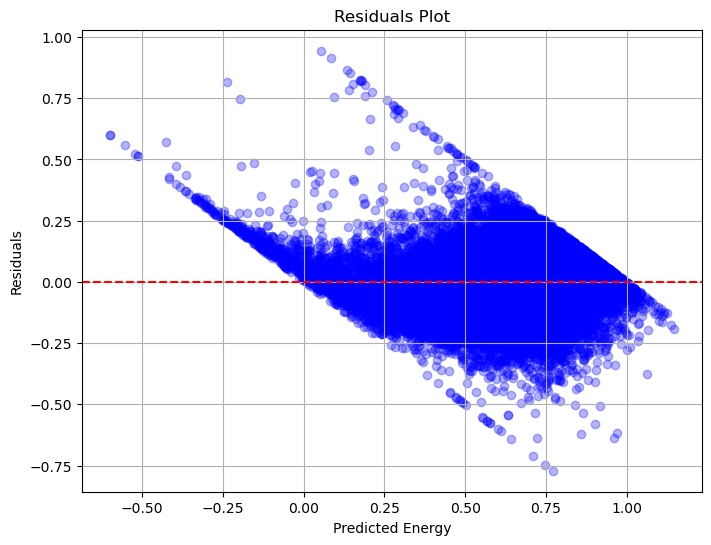

In [49]:
"""
Polynomial Regression with y = Energy; x = Loudness and degree = 1
"""

import matplotlib.pyplot as plt
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score

from sklearn.linear_model import Lasso


X_loudness = spotify_cleaned_final.select_dtypes(include=['float64', 'int64']).drop(columns=['energy'])
y_energy = spotify_cleaned_final['energy']


X_train_val, X_test, y_train_val, y_test = train_test_split(X_loudness, y_energy, test_size=1/3, random_state=35)

X_train, X_val, y_train, y_val = train_test_split(X_train_val, y_train_val, test_size=0.5, random_state=35)

# polynomial transformation to the features (degree=1)
poly = PolynomialFeatures(degree=1)
X_train_poly = poly.fit_transform(X_train)
X_val_poly = poly.transform(X_val)
X_test_poly = poly.transform(X_test)

# train the linear regression model using the transformed polynomial features
model = LinearRegression()
model.fit(X_train_poly, y_train)

print("Coefficients (Theta):", model.coef_)

print("Columns", X_loudness.columns)

# evaluate on validation set
y_pred_val = model.predict(X_val_poly)
mse_val = mean_squared_error(y_val, y_pred_val)
r2_val = r2_score(y_val, y_pred_val)
print(f"Mean Squared Error (Validation Data): {mse_val}")
print(f"R-squared (Validation Data): {r2_val}")

# once validated, evaluate on the test set (unseen data)
y_pred_test = model.predict(X_test_poly)
mse_test = mean_squared_error(y_test, y_pred_test)
r2_test = r2_score(y_test, y_pred_test)
print(f"Mean Squared Error (Test Data): {mse_test}")
print(f"R-squared (Test Data): {r2_test}")

# Check the shape of the splits
print(f"X_train shape: {X_train.shape}")
print(f"X_val shape: {X_val.shape}")
print(f"X_test shape: {X_test.shape}")
print(f"y_train shape: {y_train.shape}")
print(f"y_val shape: {y_val.shape}")
print(f"y_test shape: {y_test.shape}")

import matplotlib.pyplot as plt

# Calculate residuals for the test set
residuals = y_test - y_pred_test

# Scatter plot of residuals
plt.figure(figsize=(8, 6))
plt.scatter(y_pred_test, residuals, color='blue', alpha=0.3)
plt.axhline(y=0, color='red', linestyle='--')
plt.xlabel('Predicted Energy')
plt.ylabel('Residuals')
plt.title('Residuals Plot')
plt.grid(True)
plt.show()

Mean Squared Error (Validation Data): 0.02569201564943755
R-squared (Validation Data): 0.6156393578847112
Mean Squared Error (Test Data): 0.025009174016941596
R-squared (Test Data): 0.6260104188045967


/var/folders/dt/68cxkpfx1wn0x87d0bc_x9wc0000gn/T/ipykernel_13603/2334543473.py:50: DeprecationWarning:

Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)



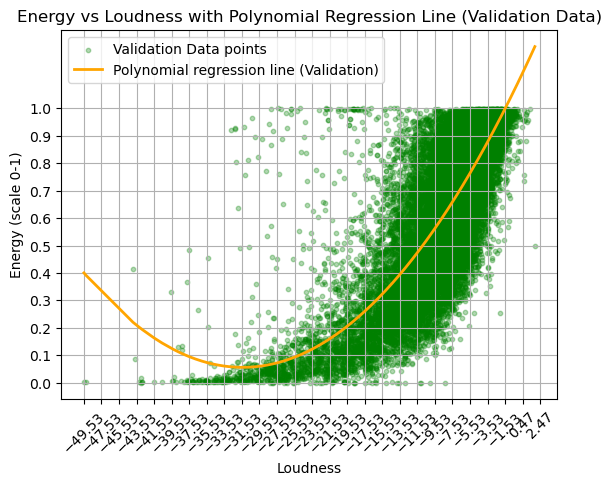

/var/folders/dt/68cxkpfx1wn0x87d0bc_x9wc0000gn/T/ipykernel_13603/2334543473.py:65: DeprecationWarning:

Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)



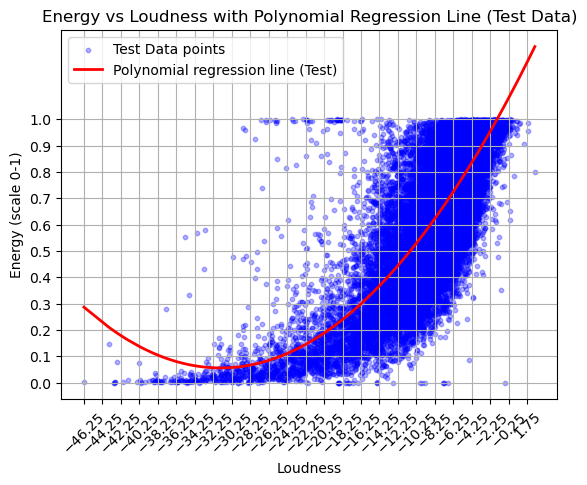

X_train shape: (27068, 1)
X_val shape: (27069, 1)
X_test shape: (27069, 1)
y_train shape: (27068,)
y_val shape: (27069,)
y_test shape: (27069,)


In [50]:
"""
Polynomial Regression with y = Energy; x = Loudness and degree=2
"""

import matplotlib.pyplot as plt
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score

X_loudness = numeric_data[['loudness']]
y_energy = numeric_data['energy']



X_train_val, X_test, y_train_val, y_test = train_test_split(X_loudness, y_energy, test_size=1/3, random_state=35)

X_train, X_val, y_train, y_val = train_test_split(X_train_val, y_train_val, test_size=0.5, random_state=35)

# polynomial transformation to the features (degree=2)
poly = PolynomialFeatures(degree=2)
X_train_poly = poly.fit_transform(X_train)
X_val_poly = poly.transform(X_val)
X_test_poly = poly.transform(X_test)

# train the linear regression model using the transformed polynomial features
model = LinearRegression()
model.fit(X_train_poly, y_train)

# evaluate on validation set
y_pred_val = model.predict(X_val_poly)
mse_val = mean_squared_error(y_val, y_pred_val)
r2_val = r2_score(y_val, y_pred_val)
print(f"Mean Squared Error (Validation Data): {mse_val}")
print(f"R-squared (Validation Data): {r2_val}")

# once validated, evaluate on the test set (unseen data)
y_pred_test = model.predict(X_test_poly)
mse_test = mean_squared_error(y_test, y_pred_test)
r2_test = r2_score(y_test, y_pred_test)
print(f"Mean Squared Error (Test Data): {mse_test}")
print(f"R-squared (Test Data): {r2_test}")

# plot the validation data points and regression line
plt.scatter(X_val, y_val, color='green', label='Validation Data points', s=10, alpha=0.3)
sorted_idx = np.argsort(X_val.values.flatten())
plt.plot(X_val.values[sorted_idx], y_pred_val[sorted_idx], color='orange', linewidth=2, label='Polynomial regression line (Validation)')

plt.xticks(np.arange(min(X_val.values), max(X_val.values)+1, 2), rotation=45, fontsize=10)
plt.yticks(np.arange(0, 1.01, 0.1))

plt.xlabel('Loudness')
plt.ylabel('Energy (scale 0-1)')
plt.title('Energy vs Loudness with Polynomial Regression Line (Validation Data)')
plt.legend()
plt.grid(True)
plt.show()

# plot the test data points and regression line
plt.scatter(X_test, y_test, color='blue', label='Test Data points', s=10, alpha=0.3)
sorted_idx = np.argsort(X_test.values.flatten())
plt.plot(X_test.values[sorted_idx], y_pred_test[sorted_idx], color='red', linewidth=2, label='Polynomial regression line (Test)')

plt.xticks(np.arange(min(X_test.values), max(X_test.values)+1, 2), rotation=45, fontsize=10)
plt.yticks(np.arange(0, 1.01, 0.1))

plt.xlabel('Loudness')
plt.ylabel('Energy (scale 0-1)')
plt.title('Energy vs Loudness with Polynomial Regression Line (Test Data)')
plt.legend()
plt.grid(True)
plt.show()

# Check the shape of the splits
print(f"X_train shape: {X_train.shape}")
print(f"X_val shape: {X_val.shape}")
print(f"X_test shape: {X_test.shape}")
print(f"y_train shape: {y_train.shape}")
print(f"y_val shape: {y_val.shape}")
print(f"y_test shape: {y_test.shape}")


## 4c. Regularization

Lasso - Mean Squared Error (Validation Data): 0.02569310985801154
Lasso - R-squared (Validation Data): 0.6156229881799811
Lasso - Mean Squared Error (Test Data): 0.025009628164784626
Lasso - R-squared (Test Data): 0.6260036274342979


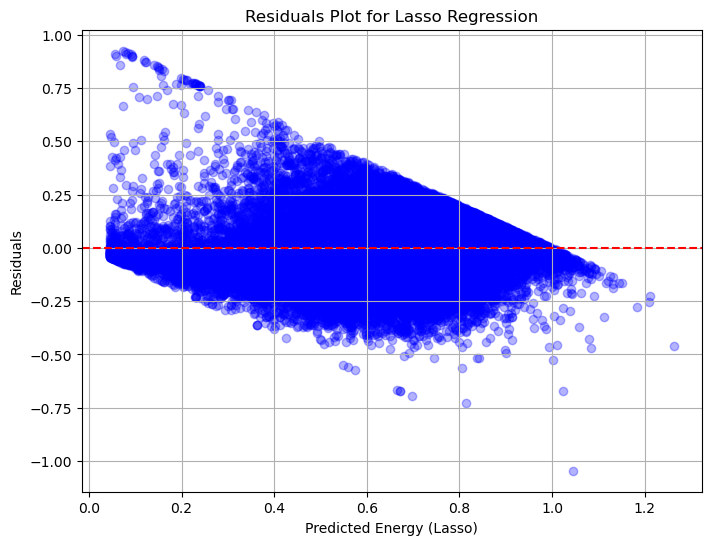

In [51]:
"""
Polynomial Regression with Regularization using Lasso Regression
"""

from sklearn.linear_model import Lasso
from sklearn.metrics import mean_squared_error, r2_score

# Step 1: Polynomial transformation (you've already done this)
poly = PolynomialFeatures(degree=2)
X_train_poly = poly.fit_transform(X_train)
X_val_poly = poly.transform(X_val)
X_test_poly = poly.transform(X_test)

# Step 2: Initialize and fit the Lasso regression model
lasso_model = Lasso(alpha=0.005)  # You can tune the alpha value
lasso_model.fit(X_train_poly, y_train)

# Step 3: Predict on validation and test sets
y_pred_val_lasso = lasso_model.predict(X_val_poly)
y_pred_test_lasso = lasso_model.predict(X_test_poly)

# Step 4: Evaluate the model performance
mse_val_lasso = mean_squared_error(y_val, y_pred_val_lasso)
r2_val_lasso = r2_score(y_val, y_pred_val_lasso)
print(f"Lasso - Mean Squared Error (Validation Data): {mse_val_lasso}")
print(f"Lasso - R-squared (Validation Data): {r2_val_lasso}")

mse_test_lasso = mean_squared_error(y_test, y_pred_test_lasso)
r2_test_lasso = r2_score(y_test, y_pred_test_lasso)
print(f"Lasso - Mean Squared Error (Test Data): {mse_test_lasso}")
print(f"Lasso - R-squared (Test Data): {r2_test_lasso}")

# Step 5: Analyze residuals for Lasso model
residuals_lasso = y_test - y_pred_test_lasso

plt.figure(figsize=(8, 6))
plt.scatter(y_pred_test_lasso, residuals_lasso, color='blue', alpha=0.3)
plt.axhline(y=0, color='red', linestyle='--')
plt.xlabel('Predicted Energy (Lasso)')
plt.ylabel('Residuals')
plt.title('Residuals Plot for Lasso Regression')
plt.grid(True)
plt.show()


Ridge - Mean Squared Error (Validation Data): 0.02343245097182436
Ridge - R-squared (Validation Data): 0.6460433821479474
Ridge - Mean Squared Error (Test Data): 0.023634578240899946
Ridge - R-squared (Test Data): 0.6503872357218634


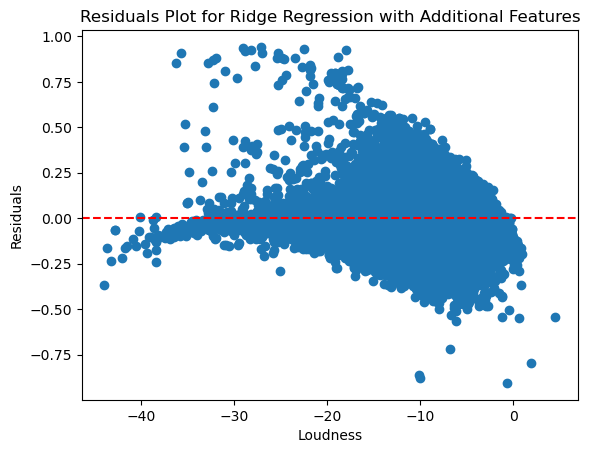

In [52]:
"""
Polynomial Regression with multiple features; Regularization (Ridge)
"""

from sklearn.linear_model import Ridge
from sklearn.preprocessing import PolynomialFeatures
from sklearn.metrics import mean_squared_error, r2_score
import matplotlib.pyplot as plt
import numpy as np

# Step 1: Select additional features along with loudness
X_features = numeric_data[['loudness', 'tempo', 'valence', 'danceability']]  # Add relevant features
y_energy = numeric_data['energy']

# Step 2: Split the data into training, validation, and test sets
X_train_val, X_test, y_train_val, y_test = train_test_split(X_features, y_energy, test_size=1/3, random_state=42)
X_train, X_val, y_train, y_val = train_test_split(X_train_val, y_train_val, test_size=0.5, random_state=42)

# Step 3: Apply polynomial transformation (degree=2 or 3) on multiple features
poly = PolynomialFeatures(degree=2)  # You can change to degree 3 if needed
X_train_poly = poly.fit_transform(X_train)
X_val_poly = poly.transform(X_val)
X_test_poly = poly.transform(X_test)

# Step 4: Train a Ridge regression model
ridge_model = Ridge(alpha=1.0)  # You can tune the alpha parameter
ridge_model.fit(X_train_poly, y_train)

# Step 5: Predict on validation and test sets
y_pred_val_ridge = ridge_model.predict(X_val_poly)
y_pred_test_ridge = ridge_model.predict(X_test_poly)

# Step 6: Evaluate the model performance
mse_val_ridge = mean_squared_error(y_val, y_pred_val_ridge)
r2_val_ridge = r2_score(y_val, y_pred_val_ridge)
print(f"Ridge - Mean Squared Error (Validation Data): {mse_val_ridge}")
print(f"Ridge - R-squared (Validation Data): {r2_val_ridge}")

mse_test_ridge = mean_squared_error(y_test, y_pred_test_ridge)
r2_test_ridge = r2_score(y_test, y_pred_test_ridge)
print(f"Ridge - Mean Squared Error (Test Data): {mse_test_ridge}")
print(f"Ridge - R-squared (Test Data): {r2_test_ridge}")

# Step 7: Plot the residuals for Ridge regression on the test set
residuals_ridge = y_test - y_pred_test_ridge
plt.scatter(X_test['loudness'], residuals_ridge)  # Scatter plot against loudness
plt.axhline(y=0, color='r', linestyle='--')
plt.xlabel('Loudness')
plt.ylabel('Residuals')
plt.title('Residuals Plot for Ridge Regression with Additional Features')
plt.show()


# 5. Logistic Regression
  * Here, we will try to use logistic regression to predict the mode of a song.
  * From the database: mode: Mode indicates the modality (major or minor) of a track, the type of scale from which its melodic content is derived. Major is represented by 1 and minor is 0


In [53]:
"""
Import the necessary libraries
"""
from sklearn.linear_model import LogisticRegression


In [54]:
"""
Preprocessing of the data by dropping all non-numeric columns
"""

spotify_cleaned_final_numeric = spotify_cleaned_final.select_dtypes(include=[np.number])


In [55]:
"""
Split the data into training and testing sets
"""

X = spotify_cleaned_final_numeric.drop(columns=['mode', 'time_signature', 'speechiness', 'liveness', 'popularity', 'duration_ms', 'loudness'])
y = spotify_cleaned_final_numeric['mode']
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42)
print("X_train columns:", X_train.columns)
print("X_val columns:", X_val.columns)

X_train columns: Index(['danceability', 'energy', 'key', 'acousticness', 'instrumentalness',
       'valence', 'tempo'],
      dtype='object')
X_val columns: Index(['danceability', 'energy', 'key', 'acousticness', 'instrumentalness',
       'valence', 'tempo'],
      dtype='object')


In [56]:
"""
Fit the logistic regression model
"""

lr_all = LogisticRegression(solver='liblinear')
lr_all.fit(X_train, y_train)
lr_all.intercept_, lr_all.coef_

(array([1.50300713]),
 array([[-1.03026204e+00, -4.50913696e-01, -8.23669755e-02,
          2.59560640e-01, -3.82487834e-01,  5.55845892e-01,
          7.52570627e-04]]))

In [57]:
"""
Evaluate binary prediction on validation set
"""
lr_all.predict(X_val)
pred_val_sample = pd.DataFrame({'actual': y_val, 'predicted': lr_all.predict(X_val)})
count_misclassified = np.sum(pred_val_sample['actual'] != pred_val_sample['predicted'])
print('Total samples:', len(y_val))
print('Misclassified samples:', count_misclassified)
print('Accuracy:', (len(y_val) - count_misclassified) / len(y_val))

Total samples: 16242
Misclassified samples: 5851
Accuracy: 0.6397611131634036


In [58]:
"""
Confusion matrix
"""

from sklearn.metrics import confusion_matrix

conf_matrix = confusion_matrix(y_val, lr_all.predict(X_val))
conf_matrix = pd.DataFrame(conf_matrix, columns=['Predicted 0', 'Predicted 1'], index=['Actual 0', 'Actual 1'])
conf_matrix

,Predicted 0,Predicted 1
Actual 0,836,5246
Actual 1,605,9555


In [59]:
"""
Prediction accuracy
"""

from sklearn.metrics import accuracy_score

print('Accuracy:', accuracy_score(y_val, lr_all.predict(X_val)))

Accuracy: 0.6397611131634036


In [60]:
"""
True positive rate
"""

print('True Positive Rate:', conf_matrix['Predicted 1']['Actual 1'] / (conf_matrix['Predicted 1']['Actual 1'] + conf_matrix['Predicted 0']['Actual 1']))

True Positive Rate: 0.9404527559055118


In [61]:
"""
True negative rate
"""

print('True Negative Rate:', conf_matrix['Predicted 0']['Actual 0'] / (conf_matrix['Predicted 0']['Actual 0'] + conf_matrix['Predicted 1']['Actual 0']))

True Negative Rate: 0.13745478461032556


In [62]:
"""
ROC curve 
"""

from sklearn.metrics import roc_curve

# lr_all.predict_proba(X_val) will return the probabilities of the negative and positive classes respectively
# We are interested in the positive class so we slice the second column
positive_class_prob = lr_all.predict_proba(X_val)[:, 1]

# Compute the ROC curve variables
false_positive_rate, true_positive_rate, thresholds = roc_curve(y_val, positive_class_prob)

# Create a DataFrame to store the ROC curve variables, 
# which 'False Positive Rate' and 'True Positive Rate' and 'Model' as columns 
# and the thresholds as the index
roc_lr_sample = pd.DataFrame({
    'False Positive Rate': false_positive_rate,
    'True Positive Rate': true_positive_rate,
    'Model': 'Logistic Regression'
}, index=thresholds)

roc_sample_df = pd.concat([roc_lr_sample])

px.line(roc_lr_sample, y='True Positive Rate', x='False Positive Rate',
        color='Model',
        width=700, height=500
)

In [63]:
"""
AUC score
"""

from sklearn.metrics import roc_auc_score

lr_auc_score = roc_auc_score(y_val, positive_class_prob)
print('AUC Score:', lr_auc_score)

AUC Score: 0.6089515467094072


In [64]:
"""
Implementing 5-Fold Cross Validation
"""
from sklearn.model_selection import cross_val_score, cross_validate
from sklearn.linear_model import LogisticRegression

# Creating a list to store cross-validation scores
log_cv_scores = []
log_reg = LogisticRegression(solver='liblinear')

X = spotify_cleaned_final_numeric.drop(columns=['mode', 'time_signature', 'speechiness', 'liveness', 'popularity', 'duration_ms'])
y = spotify_cleaned_final_numeric['mode']

log_cv_scores = cross_validate(estimator=log_reg,
                              X=X,
                              y=y,
                              cv=5,
                              scoring='neg_root_mean_squared_error')

log_cv_scores['test_score']

array([-0.59411596, -0.59304509, -0.59423787, -0.59480749, -0.59573841])

# 6. KNN

In [65]:
"""
We will continue choosing mode as our response variable and apply KNN classification
"""

from sklearn.neighbors import KNeighborsClassifier
from sklearn.preprocessing import StandardScaler

# print all columns
print(spotify_cleaned_final.columns)

Index(['track_id', 'artists', 'album_name', 'track_name', 'popularity',
       'duration_ms', 'explicit', 'danceability', 'energy', 'key', 'loudness',
       'mode', 'speechiness', 'acousticness', 'instrumentalness', 'liveness',
       'valence', 'tempo', 'time_signature', 'track_genre'],
      dtype='object')


In [66]:
"""
Remove unnecessary columns such as track_id, track_name, artists, track_genre, album_name, and popularity
"""

spotify_cleaned_final_knn = spotify_cleaned_final.drop(columns=['track_id', 'track_name', 'artists', 'track_genre', 'popularity', 'album_name'])
print(spotify_cleaned_final_knn.columns)


Index(['duration_ms', 'explicit', 'danceability', 'energy', 'key', 'loudness',
       'mode', 'speechiness', 'acousticness', 'instrumentalness', 'liveness',
       'valence', 'tempo', 'time_signature'],
      dtype='object')


In [67]:
spotify_cleaned_final_knn.head(10)


,duration_ms,explicit,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature
36750,178533,True,0.823,0.61200,1,-7.767,1,0.2480,0.168000,0.00000,0.1090,0.6880,142.959,4
92751,151680,False,0.615,0.37500,0,-10.362,0,0.0319,0.482000,0.00000,0.1110,0.9220,110.720,4
66996,86675,False,0.664,0.61100,3,-8.687,1,0.0886,0.120000,0.00000,0.0408,0.7580,118.443,4
101161,289133,False,0.111,0.05680,10,-28.053,1,0.0551,0.990000,0.69700,0.1100,0.0395,169.401,1
82584,180706,False,0.565,0.97700,11,-3.592,1,0.0546,0.028200,0.00132,0.4330,0.3870,106.478,4
5980,319906,False,0.264,0.95100,7,-7.356,1,0.1460,0.000894,0.04420,0.1270,0.1590,149.990,4
93397,235547,False,0.167,0.33200,1,-9.888,1,0.0359,0.992000,0.19100,0.1130,0.0527,62.970,4
93895,111800,False,0.443,0.51400,10,-8.068,1,0.0924,0.988000,0.00187,0.0918,0.2440,100.752,4
79999,179400,False,0.444,0.00402,2,-35.904,0,0.0750,0.996000,0.90800,0.0599,0.0385,90.026,0
39347,313080,False,0.208,0.34700,9,-16.183,1,0.0670,0.658000,0.12800,0.9640,0.0794,121.408,4


In [68]:
spotify_cleaned_final_knn.shape

(81206, 14)

In [69]:
"""
Fit the KNN model with the training data
"""

X = spotify_cleaned_final_knn.drop(columns=['mode'])
y = spotify_cleaned_final_knn['mode']
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42)

# scaler = StandardScaler()
# X_train = scaler.fit_transform(X_train)

knn_3 = KNeighborsClassifier(n_neighbors=3)
knn_3.fit(X_train, y_train)

knn = KNeighborsClassifier(n_neighbors=5)
knn.fit(X_train, y_train)

knn_7 = KNeighborsClassifier(n_neighbors=7)
knn_7.fit(X_train, y_train)

knn_15 = KNeighborsClassifier(n_neighbors=15)
knn_15.fit(X_train, y_train)

knn_30 = KNeighborsClassifier(n_neighbors=30)
knn_30.fit(X_train, y_train)




KNeighborsClassifier(n_neighbors=30)

In [70]:
"""
Calculate confusion matrix
"""

conf_matrix_knn_3 = confusion_matrix(y_train, knn_3.predict(X_train))
conf_matrix_knn_3 = pd.DataFrame(conf_matrix_knn_3, columns=['Predicted 0', 'Predicted 1'], index=['Actual 0', 'Actual 1'])
print("Confusion Matrix for KNN with 3 neighbors")
print(conf_matrix_knn_3)
print("~~~")

conf_matrix_knn = confusion_matrix(y_train, knn.predict(X_train))
conf_matrix_knn = pd.DataFrame(conf_matrix_knn, columns=['Predicted 0', 'Predicted 1'], index=['Actual 0', 'Actual 1'])
print("Confusion Matrix for KNN with 5 neighbors")
print(conf_matrix_knn)
print("~~~")

conf_matrix_knn_7 = confusion_matrix(y_train, knn_7.predict(X_train))
conf_matrix_knn_7 = pd.DataFrame(conf_matrix_knn_7, columns=['Predicted 0', 'Predicted 1'], index=['Actual 0', 'Actual 1'])
print("Confusion Matrix for KNN with 7 neighbors")
print(conf_matrix_knn_7)
print("~~~")

conf_matrix_knn_15 = confusion_matrix(y_train, knn_15.predict(X_train))
conf_matrix_knn_15 = pd.DataFrame(conf_matrix_knn_15, columns=['Predicted 0', 'Predicted 1'], index=['Actual 0', 'Actual 1'])
print("Confusion Matrix for KNN with 15 neighbors")
print(conf_matrix_knn_15)
print("~~~")

conf_matrix_knn_30 = confusion_matrix(y_train, knn_30.predict(X_train))
conf_matrix_knn_30 = pd.DataFrame(conf_matrix_knn_30, columns=['Predicted 0', 'Predicted 1'], index=['Actual 0', 'Actual 1'])
print("Confusion Matrix for KNN with 30 neighbors")
print(conf_matrix_knn_30)
print("~~~")



Confusion Matrix for KNN with 3 neighbors
          Predicted 0  Predicted 1
Actual 0        14591         9192
Actual 1         5724        35457
~~~
Confusion Matrix for KNN with 5 neighbors
          Predicted 0  Predicted 1
Actual 0        11625        12158
Actual 1         6003        35178
~~~
Confusion Matrix for KNN with 7 neighbors
          Predicted 0  Predicted 1
Actual 0         9811        13972
Actual 1         5833        35348
~~~
Confusion Matrix for KNN with 15 neighbors
          Predicted 0  Predicted 1
Actual 0         5896        17887
Actual 1         4312        36869
~~~
Confusion Matrix for KNN with 30 neighbors
          Predicted 0  Predicted 1
Actual 0         3861        19922
Actual 1         3486        37695
~~~


In [71]:
"""
Calculate Prediction accuracy
"""

# Data

neighbors = [3, 5, 7, 15, 30]
accuracies = [
    accuracy_score(y_train, knn_3.predict(X_train)),
    accuracy_score(y_train, knn.predict(X_train)),
    accuracy_score(y_train, knn_7.predict(X_train)),
    accuracy_score(y_train, knn_15.predict(X_train)),
    accuracy_score(y_train, knn_30.predict(X_train)),
]

# Create a DataFrame
knn_model_performance_df = pd.DataFrame({
    "Number of Neighbors": neighbors,
    "Accuracy": accuracies
})

# Display the DataFrame
print(knn_model_performance_df)



   Number of Neighbors  Accuracy
0                    3  0.770396
1                    5  0.720445
2                    7  0.695139
3                   15  0.658288
4                   30  0.639677


In [72]:
"""
Calculate Prediction Error
"""
prediction_error = [
    1 - accuracy_score(y_train, knn_3.predict(X_train)),
    1 - accuracy_score(y_train, knn.predict(X_train)),
    1 - accuracy_score(y_train, knn_7.predict(X_train)),
    1 - accuracy_score(y_train, knn_15.predict(X_train)),
    1 - accuracy_score(y_train, knn_30.predict(X_train))
]

knn_model_performance_df["Prediction Error"] = prediction_error
print(knn_model_performance_df)


   Number of Neighbors  Accuracy  Prediction Error
0                    3  0.770396          0.229604
1                    5  0.720445          0.279555
2                    7  0.695139          0.304861
3                   15  0.658288          0.341712
4                   30  0.639677          0.360323


In [73]:
"""
Calculate True Positive Rate
"""
TPR = [
    conf_matrix_knn_3['Predicted 1']['Actual 1'] / (conf_matrix_knn_3['Predicted 1']['Actual 1'] + conf_matrix_knn_3['Predicted 0']['Actual 1']),
    conf_matrix_knn['Predicted 1']['Actual 1'] / (conf_matrix_knn['Predicted 1']['Actual 1'] + conf_matrix_knn['Predicted 0']['Actual 1']),
    conf_matrix_knn_7['Predicted 1']['Actual 1'] / (conf_matrix_knn_7['Predicted 1']['Actual 1'] + conf_matrix_knn_7['Predicted 0']['Actual 1']),
    conf_matrix_knn_15['Predicted 1']['Actual 1'] / (conf_matrix_knn_15['Predicted 1']['Actual 1'] + conf_matrix_knn_15['Predicted 0']['Actual 1']),
    conf_matrix_knn_30['Predicted 1']['Actual 1'] / (conf_matrix_knn_30['Predicted 1']['Actual 1'] + conf_matrix_knn_30['Predicted 0']['Actual 1'])
]

knn_model_performance_df["True Positive Rate"] = TPR
print(knn_model_performance_df)


   Number of Neighbors  Accuracy  Prediction Error  True Positive Rate
0                    3  0.770396          0.229604            0.861004
1                    5  0.720445          0.279555            0.854229
2                    7  0.695139          0.304861            0.858357
3                   15  0.658288          0.341712            0.895292
4                   30  0.639677          0.360323            0.915349


In [74]:
"""
Calculate True Negative Rate
"""
TNR = [
    conf_matrix_knn_3['Predicted 0']['Actual 0'] / (conf_matrix_knn_3['Predicted 0']['Actual 0'] + conf_matrix_knn_3['Predicted 1']['Actual 0']),
    conf_matrix_knn['Predicted 0']['Actual 0'] / (conf_matrix_knn['Predicted 0']['Actual 0'] + conf_matrix_knn['Predicted 1']['Actual 0']),
    conf_matrix_knn_7['Predicted 0']['Actual 0'] / (conf_matrix_knn_7['Predicted 0']['Actual 0'] + conf_matrix_knn_7['Predicted 1']['Actual 0']),
    conf_matrix_knn_15['Predicted 0']['Actual 0'] / (conf_matrix_knn_15['Predicted 0']['Actual 0'] + conf_matrix_knn_15['Predicted 1']['Actual 0']),
    conf_matrix_knn_30['Predicted 0']['Actual 0'] / (conf_matrix_knn_30['Predicted 0']['Actual 0'] + conf_matrix_knn_30['Predicted 1']['Actual 0'])
]

knn_model_performance_df["True Negative Rate"] = TNR
print(knn_model_performance_df)


   Number of Neighbors  Accuracy  Prediction Error  True Positive Rate  \
0                    3  0.770396          0.229604            0.861004   
1                    5  0.720445          0.279555            0.854229   
2                    7  0.695139          0.304861            0.858357   
3                   15  0.658288          0.341712            0.895292   
4                   30  0.639677          0.360323            0.915349   

   True Negative Rate  
0            0.613505  
1            0.488795  
2            0.412522  
3            0.247908  
4            0.162343  


In [75]:
"""
F1 Score
"""

from sklearn.metrics import f1_score

F1_Score = [
    f1_score(y_train, knn_3.predict(X_train)),
    f1_score(y_train, knn.predict(X_train)),
    f1_score(y_train, knn_7.predict(X_train)),
    f1_score(y_train, knn_15.predict(X_train)),
    f1_score(y_train, knn_30.predict(X_train))
]

knn_model_performance_df["F1_Score"] = F1_Score
print(knn_model_performance_df)
# print('F1 Score for KNN with 3 neighbors:', f1_score(y_train, knn_3.predict(X_train)))
# print('F1 Score for KNN with 5 neighbors:', f1_score(y_train, knn.predict(X_train)))
# print('F1 Score for KNN with 7 neighbors:', f1_score(y_train, knn_7.predict(X_train)))
# print('F1 Score for KNN with 15 neighbors:', f1_score(y_train, knn_15.predict(X_train)))
# print('F1 Score for KNN with 30 neighbors:', f1_score(y_train, knn_30.predict(X_train)))

   Number of Neighbors  Accuracy  Prediction Error  True Positive Rate  \
0                    3  0.770396          0.229604            0.861004   
1                    5  0.720445          0.279555            0.854229   
2                    7  0.695139          0.304861            0.858357   
3                   15  0.658288          0.341712            0.895292   
4                   30  0.639677          0.360323            0.915349   

   True Negative Rate  F1_Score  
0            0.613505  0.826215  
1            0.488795  0.794830  
2            0.412522  0.781163  
3            0.247908  0.768609  
4            0.162343  0.763072  


In [76]:
"""
ROC curve for Logistic Regression and KNN 5 neighbors, and KNN 7 neighbors, and KNN 15 neighbors, and KNN 30 neighbors
"""
positive_class_prob_knn_3 = knn_3.predict_proba(X_train)[:, 1]
positive_class_prob_knn = knn.predict_proba(X_train)[:, 1]
positive_class_prob_knn_7 = knn_7.predict_proba(X_train)[:, 1]
positive_class_prob_knn_15 = knn_15.predict_proba(X_train)[:, 1]
positive_class_prob_knn_30 = knn_30.predict_proba(X_train)[:, 1]

false_positive_rate_knn_3, true_positive_rate_knn_3, thresholds_knn_3 = roc_curve(y_train, positive_class_prob_knn_3)
false_positive_rate_knn, true_positive_rate_knn, thresholds_knn = roc_curve(y_train, positive_class_prob_knn)
false_positive_rate_knn_7, true_positive_rate_knn_7, thresholds_knn_7 = roc_curve(y_train, positive_class_prob_knn_7)
false_positive_rate_knn_15, true_positive_rate_knn_15, thresholds_knn_15 = roc_curve(y_train, positive_class_prob_knn_15)
false_positive_rate_knn_30, true_positive_rate_knn_30, thresholds_knn_30 = roc_curve(y_train, positive_class_prob_knn_30)

roc_knn_3 = pd.DataFrame({
    'False Positive Rate': false_positive_rate_knn_3,
    'True Positive Rate': true_positive_rate_knn_3,
    'Model': 'KNN 3'
}, index=thresholds_knn_3)

roc_knn = pd.DataFrame({
    'False Positive Rate': false_positive_rate_knn,
    'True Positive Rate': true_positive_rate_knn,
    'Model': 'KNN 5'
}, index=thresholds_knn)

roc_knn_7 = pd.DataFrame({
    'False Positive Rate': false_positive_rate_knn_7,
    'True Positive Rate': true_positive_rate_knn_7,
    'Model': 'KNN 7'
}, index=thresholds_knn_7)

roc_knn_15 = pd.DataFrame({
    'False Positive Rate': false_positive_rate_knn_15,
    'True Positive Rate': true_positive_rate_knn_15,
    'Model': 'KNN 15'
}, index=thresholds_knn_15)

roc_knn_30 = pd.DataFrame({
    'False Positive Rate': false_positive_rate_knn_30,
    'True Positive Rate': true_positive_rate_knn_30,
    'Model': 'KNN 30'
}, index=thresholds_knn_30)

roc_sample_df = pd.concat([roc_lr_sample, roc_knn_3, roc_knn, roc_knn_7, roc_knn_15, roc_knn_30])

px.line(roc_sample_df, y='True Positive Rate', x='False Positive Rate', color='Model', width=700, height=500)





In [77]:
"""
AUC Score
"""

auc_score = [
    roc_auc_score(y_train, positive_class_prob_knn_3),
    roc_auc_score(y_train, positive_class_prob_knn),
    roc_auc_score(y_train, positive_class_prob_knn_7),
    roc_auc_score(y_train, positive_class_prob_knn_15),
    roc_auc_score(y_train, positive_class_prob_knn_30)
]

knn_model_performance_df["AUC Score"] = auc_score
print(knn_model_performance_df)

# knn_auc_score_3 = roc_auc_score(y_train, positive_class_prob_knn_3)
# knn_auc_score = roc_auc_score(y_train, positive_class_prob_knn)
# knn_auc_score_7 = roc_auc_score(y_train, positive_class_prob_knn_7)
# knn_auc_score_15 = roc_auc_score(y_train, positive_class_prob_knn_15)
# knn_auc_score_30 = roc_auc_score(y_train, positive_class_prob_knn_30)

# print('AUC Score for KNN with 3 neighbors:', knn_auc_score_3)
# print('AUC Score for KNN with 5 neighbors:', knn_auc_score)
# print('AUC Score for KNN with 7 neighbors:', knn_auc_score_7)
# print('AUC Score for KNN with 15 neighbors:', knn_auc_score_15)
# print('AUC Score for KNN with 30 neighbors:', knn_auc_score_30)


   Number of Neighbors  Accuracy  Prediction Error  True Positive Rate  \
0                    3  0.770396          0.229604            0.861004   
1                    5  0.720445          0.279555            0.854229   
2                    7  0.695139          0.304861            0.858357   
3                   15  0.658288          0.341712            0.895292   
4                   30  0.639677          0.360323            0.915349   

   True Negative Rate  F1_Score  AUC Score  
0            0.613505  0.826215   0.826294  
1            0.488795  0.794830   0.762310  
2            0.412522  0.781163   0.725869  
3            0.247908  0.768609   0.657526  
4            0.162343  0.763072   0.609395  


In [78]:
"""
Implementing 5-Fold Cross Validation and calculate the AUC and Accuracy of each fold
"""

knn_3 = KNeighborsClassifier(n_neighbors=3)
knn = KNeighborsClassifier(n_neighbors=5)
knn_7 = KNeighborsClassifier(n_neighbors=7)
knn_15 = KNeighborsClassifier(n_neighbors=15)
knn_30 = KNeighborsClassifier(n_neighbors=30)

knn_cv_scores_3 = cross_validate(estimator=knn_3, X=X, y=y, cv=5, scoring=['accuracy', 'roc_auc'])
knn_cv_scores = cross_validate(estimator=knn, X=X, y=y, cv=5, scoring=['accuracy', 'roc_auc'])
knn_7_cv_scores = cross_validate(estimator=knn_7, X=X, y=y, cv=5, scoring=['accuracy', 'roc_auc'])
knn_15_cv_scores = cross_validate(estimator=knn_15, X=X, y=y, cv=5, scoring=['accuracy', 'roc_auc'])
knn_30_cv_scores = cross_validate(estimator=knn_30, X=X, y=y, cv=5, scoring=['accuracy', 'roc_auc'])

print('Accuracy for KNN with 3 neighbors:', knn_cv_scores_3['test_accuracy'])
print('AUC for KNN with 3 neighbors:', knn_cv_scores_3['test_roc_auc'])

print('Accuracy for KNN with 5 neighbors:', knn_cv_scores['test_accuracy'])
print('AUC for KNN with 5 neighbors:', knn_cv_scores['test_roc_auc'])

print('Accuracy for KNN with 7 neighbors:', knn_7_cv_scores['test_accuracy'])
print('AUC for KNN with 7 neighbors:', knn_7_cv_scores['test_roc_auc'])

print('Accuracy for KNN with 15 neighbors:', knn_15_cv_scores['test_accuracy'])
print('AUC for KNN with 15 neighbors:', knn_15_cv_scores['test_roc_auc'])

print('Accuracy for KNN with 30 neighbors:', knn_30_cv_scores['test_accuracy'])
print('AUC for KNN with 30 neighbors:', knn_30_cv_scores['test_roc_auc'])

Accuracy for KNN with 3 neighbors: [0.55190248 0.55199803 0.54996614 0.55304476 0.54651807]
AUC for KNN with 3 neighbors: [0.5063638  0.51042014 0.5016016  0.50593872 0.49858526]
Accuracy for KNN with 5 neighbors: [0.5624923  0.57003879 0.56234222 0.5628348  0.55926359]
AUC for KNN with 5 neighbors: [0.50485298 0.51776449 0.50727289 0.50431155 0.50002853]
Accuracy for KNN with 7 neighbors: [0.57308213 0.5749646  0.57163968 0.57527246 0.56622129]
AUC for KNN with 7 neighbors: [0.50663244 0.5161885  0.50858962 0.50585357 0.50129693]
Accuracy for KNN with 15 neighbors: [0.59339983 0.59867003 0.59392895 0.59429838 0.59103503]
AUC for KNN with 15 neighbors: [0.51063605 0.52072893 0.51168156 0.50539115 0.50137079]
Accuracy for KNN with 30 neighbors: [0.60589829 0.61030725 0.60408842 0.60599717 0.59934733]
AUC for KNN with 30 neighbors: [0.51306666 0.51190858 0.50955238 0.50400219 0.50411704]


Exploring 3-NN with different p values for Minkowski Distance

In [79]:
# KNN with p=1 (Manhattan distance)
knn_manhattan = KNeighborsClassifier(n_neighbors=3, metric='minkowski', p=1)
knn_manhattan.fit(X_train, y_train)

# KNN with p=2 (Euclidean distance)
knn_euclidean = KNeighborsClassifier(n_neighbors=3, metric='minkowski', p=2)
knn_euclidean.fit(X_train, y_train)

# KNN with custom p=3
knn_custom = KNeighborsClassifier(n_neighbors=3, metric='minkowski', p=5)
knn_custom.fit(X_train, y_train)

KNeighborsClassifier(n_neighbors=3, p=5)

In [80]:

knn_manhattan_cv_scores = cross_validate(estimator=knn_manhattan, X=X, y=y, cv=5, scoring=['accuracy', 'roc_auc'])
knn_euclidian_cv_scores = cross_validate(estimator=knn_euclidean, X=X, y=y, cv=5, scoring=['accuracy', 'roc_auc'])
knn_custom_cv_scores = cross_validate(estimator=knn_custom, X=X, y=y, cv=5, scoring=['accuracy', 'roc_auc'])

print("Accuracy for 3-NN P=1:", knn_manhattan_cv_scores['test_accuracy'])
print("Accuracy for 3-NN P=2:", knn_euclidian_cv_scores['test_accuracy'])
print("Accuracy for 3-NN P=3:", knn_custom_cv_scores['test_accuracy'])

Accuracy for 3-NN P=1: [0.5546115  0.55821686 0.55021243 0.55753956 0.55156702]
Accuracy for 3-NN P=2: [0.55190248 0.55199803 0.54996614 0.55304476 0.54651807]
Accuracy for 3-NN P=3: [0.55350326 0.5540915  0.5495967  0.55569238 0.54885783]
